In [3]:
import numpy as np
import pandas as pd
import glob, os
import itertools
import matplotlib.image as mpimg
import cv2
import pickle
import math
import json

# import classifier

%matplotlib inline
import matplotlib.pyplot as plt

In [42]:
def max_detection(detections):
    if len(detections) == 0:
        return 0
    return max([d[1] for d in detections])

def accu_detection(detections):
    return sum([d[1] for d in detections])


In [44]:
def load_dets_json(fn):
    with open(fn, 'r') as f:
        data = json.load(f)
        return list(map(lambda x: accu_detection(x['detections']), data))

lll = [ (fn.split('/')[-1].split('_')[0], fn) for fn in glob.glob('/data1/yolo/validation/data_tsd_prod/out/*_*.mp4.json')]
printers = pd.DataFrame(lll, columns=('printer_id', 'tl_id'))
printers['dets'] = df.fn.apply(load_dets_json)
printer_ids = list(set(printers.printer_id))
printer_map = list(map(lambda x: (x, np.array(sum(list(printers[printers.printer_id == x].dets), []))), printer_ids))

NameError: name 'df' is not defined

In [84]:
ppp = list(map(lambda x: (x[0], np.mean(x[1]), np.std(x[1])), printer_map))
np.mean(np.array(ppp).astype(np.float)[:,1])

0.059567169301883716

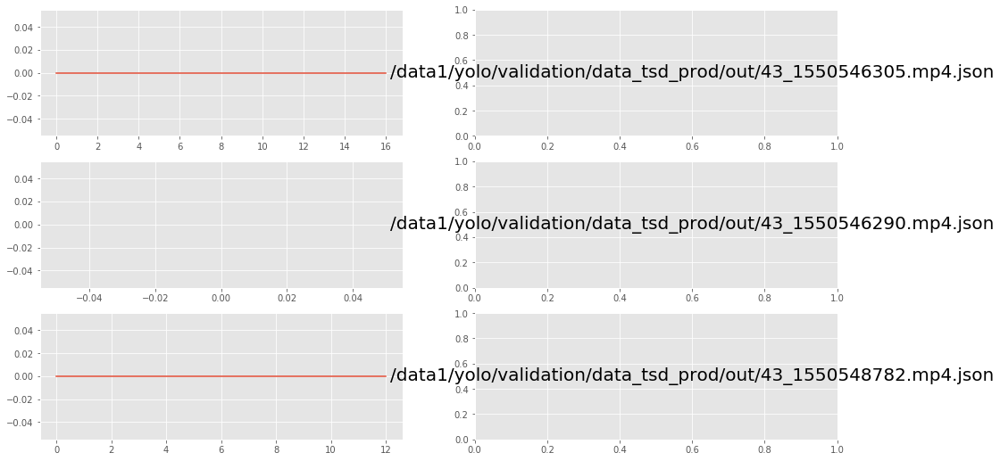

In [70]:
plt.style.use('ggplot')
tl_ids = printers[printers.printer_id == '43'][:150].tl_id
fig=plt.figure(figsize=(16, 16*len(tl_ids)/4))

for i, tl_id in enumerate(tl_ids):
    fig.add_subplot(len(tl_ids)+1, 2, 2*i+1)
    pd.Series(np.array(load_dets_json(tl_id))).ewm(span=20).mean().plot()
    fig.add_subplot(len(tl_ids)+1, 2, 2*i+2)
    plt.text(0.6, 0.5, tl_id, size=20, ha="center", va="center",)

In [3]:
def pseudo_moving_avg(input):
    count = 0
    mean = 0
    
    output = []
    for i in input:
        if count < 80:
            count += 1
        diff =  (i - mean )/float(10000)
        mean = mean + diff
        output += [mean]
    
    return output


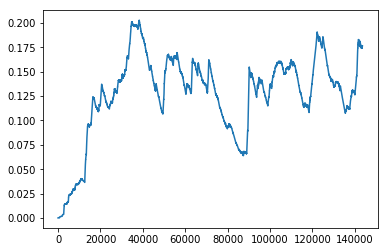

In [22]:
plt.plot(np.array(pseudo_moving_avg(printer_map[6][1])))

In [28]:
# file_list = sorted(glob.glob('/data1/yolo/validation/jpgs/*.jpg'))
# net_main_1, meta_main_1 = classifier.load_net("/data1/yolo/model/yolov2-voc.cfg", "/data1/yolo/model/weights/backup.3562.neg/yolov2-voc_14144.weights", "/data1/yolo/model/obj.data.3562.neg")
# all_detections = [(f, classifier.detect(net_main_1, meta_main_1, cv2.imread(f), thresh=0.25)) for idx, f in enumerate(file_list) if idx % 1 == 0]

# with open('/tmp/all_detections.pkl', 'wb') as f:
#     pickle.dump(all_detections, f)

all_detections = pickle.load( open( "/tmp/all_detections.pkl", "rb" ) )

def load_detections(vid):
    dets = [{"index": int(d[0][-9:-4]), "detections": d[1], "file": d[0]}  for d in all_detections if "/{}-".format(vid) in d[0]]
    df = pd.DataFrame(dets)
    df['accu_detection'] = df.detections.apply(accu_detection)
    df['rolling_ewm'] = df.accu_detection.ewm(span=20).mean()
    return df.set_index("index")

In [9]:
all_detections1 = pickle.load( open( "/mnt/ml-data1/stage2/dataset1/detections.pkl", "rb" ) )
# all_detections2 = pickle.load( open( "/mnt/ml-data1/stage2/dataset2/detections.pkl", "rb" ) )
detection_df1 = pd.DataFrame([ {'vid': d[0].split('-')[0].split('/')[-1], 'fid': int(d[0].split('-')[1].split('.')[0]), 'detections': d[1]} for d in all_detections1])
# detection_df2 = pd.DataFrame([ {'vid': d[0].split('-')[0].split('/')[-1], 'fid': int(d[0].split('-')[1].split('.')[0]), 'detections': d[1]} for d in all_detections2])
real_starts_df1 = pd.read_csv('/mnt/ml-data1/stage2/dataset1/failure_starts.csv', index_col=0, names=['start'])
# real_starts_df2 = pd.read_csv('/mnt/ml-data1/stage2/dataset2/failure_starts.csv', index_col=0, names=['start'])

real_starts_df1.index = real_starts_df1.index.astype('int64')
real_starts_df1 = real_starts_df1.sort_index()
# real_starts_df2.index = real_starts_df2.index.astype('int64')
# real_starts_df2 = real_starts_df2.sort_index()
detection_df = detection_df1
failure_starts = real_starts_df1

In [14]:
def sum_above_threshold(dets, threshold=0.25):
    return sum([d[1] for d in dets if d[1] > threshold])

def dataset_from_df(df):
    df['accu_detection'] = df.detections.apply(sum_above_threshold)
    df['rolling_ewm'] = df.accu_detection.ewm(span=20).mean()
    return df

def load_detections(vid):
    df = detection_df[detection_df.vid == vid].reset_index()
    return dataset_from_df(df)

vids = [str(i) for i in failure_starts.index.values.tolist()]

In [38]:

def video_fp_fn(vids, failure_starts, v_thresh, rolling_multiple, rolling_win, min_ewm, plot=False):
    if plot:
        plt.style.use('ggplot')
        fig=plt.figure(figsize=(16, 16*math.ceil(len(vids)/7)))

    fp = []
    fn = []
    for j, vid in enumerate(vids):
        det = load_detections(vid)
        det['rolling_mean'] = det.accu_detection.rolling(int(rolling_win), win_type='triang').mean().fillna(np.inf)
        failure_start = failure_starts.loc[int(vid)].start

        detected_failures = det.index[det.rolling_ewm > v_thresh]
        detected_failures_mean = det.index[(det.rolling_ewm > det.rolling_mean*rolling_multiple) & (det.rolling_ewm > min_ewm)]
        if failure_start > 0:
            if len(detected_failures) == 0 and len(detected_failures_mean) == 0:
                fn += [vid]
            elif len(detected_failures) > 0 and detected_failures[0] < failure_start or len(detected_failures_mean) > 0 and detected_failures_mean[0] < failure_start:
                fp += [vid]

        if plot:
            fig.add_subplot(len(vids)+1, 2, 2*j+1)
#             line_sum_p, = plt.plot(det.accu_detection, label='sum(p) for all detected boxes')
            line_ewm_mean, = plt.plot(det.rolling_ewm, label='EWM mean for sum(p)')
            line_rolling_mean, = plt.plot(det.rolling_mean, label='rolling mean for sum(p)')
            plt.axvline(x=failure_start, color='b')
            if len(detected_failures) > 0:
                plt.axvline(x=detected_failures[0], color='g')
            if len(detected_failures_mean) > 0:
                plt.axvline(x=detected_failures_mean[0], color='y')
#             plt.legend(handles=[line_sum_p, line_ewm_mean, line_rolling_mean])
            fig.add_subplot(len(vids)+1, 2, 2*j+2)
            plt.text(0.6, 0.5, vid, size=20, ha="center", va="center",)

    return fp, fn

In [40]:
fp, fn = video_fp_fn(vids, failure_starts, 0.72, 5.43, 88, 0.175, plot=False)
print(len(vids), len(fp), len(fn))

Int64Index([  14,  374,  382,  390,  391,  392,  393,  398,  402,  407,
            ...
            2361, 2362, 2363, 2364, 2365, 2366, 2367, 2368, 2369, 2370],
           dtype='int64', length=958)


,current_frame_num,accu_detection,rolling_ewm,rolling_mean
0,1,0.600602,0.120120,0.300301
1,2,0.895534,0.275203,0.498712
2,3,0.635108,0.347184,0.532811
3,4,0.291366,0.336020,0.484522
4,5,0.330467,0.334910,0.458846
5,6,0.320306,0.331989,0.439055
6,7,0.298050,0.325201,0.421429
7,8,0.308291,0.321819,0.408858
8,9,0.555923,0.368640,0.423565
9,10,0.608164,0.416545,0.440347


In [13]:
def plot_detections(img_file, detection):
    img = cv2.imread(img_file)[...,::-1].astype(np.uint8).copy() 
    for d in detection:
        score = '%.2f' % d[1]
        (xc, yc, w, h) = map(int, d[2])
        img = cv2.rectangle(img,(xc-w//2,yc-h//2),(xc+w//2,yc+w//2),(0,255,0),3)
        font = cv2.FONT_HERSHEY_SIMPLEX
        img = cv2.putText(img,score,(xc-w//2,yc-h//2-10), font, 1,(255,0,0),3,cv2.LINE_AA)
    plt.imshow(img)

Good


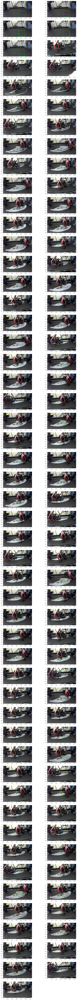

Bad


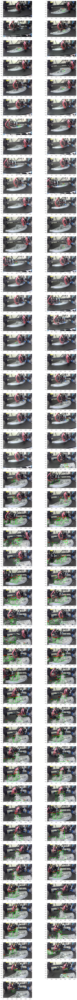

In [27]:
import pprint
pp = pprint.PrettyPrinter(indent=4)

tlid = '199306'

detections = load_detections(tlid)
start = failure_starts.loc[int(tlid)].start
good_dets = detections.loc[:start]
bad_dets = detections.loc[start:]

print("Good")
good_dets = good_dets.iloc[np.arange(0, len(good_dets)) %int(len(good_dets)/100) == 0]
fig=plt.figure(figsize=(16, 16*len(good_dets)/8))

i = 1    
for _,d in good_dets.iterrows():
    ax = fig.add_subplot(len(good_dets)/2+1, 2, i)
    ax.grid(False)
    plot_detections(d.file, d.detections)
    i += 1
plt.show()

print("Bad")
bad_dets = bad_dets.iloc[np.arange(0, len(bad_dets)) %int(len(bad_dets)/100) == 0]
fig=plt.figure(figsize=(16, 16*len(bad_dets)/8))

i = 1
for _,d in bad_dets.iterrows():
    ax = fig.add_subplot(len(bad_dets)/2+1, 2, i)
    ax.grid(False)
    plot_detections(d.file, d.detections)
    i += 1
plt.show()


In [50]:
results = []
for t in np.linspace(0.2, 0.8, 60):
    fp, fn = video_fp_fn(vids, failure_starts, t, 12.5, 80, 0.175)
    results += [[len(fp), len(fn)]]

    print(len(fn))
    print(len(fp))
    print(len(fp+fn))

53
82
135
56
78
134
58
72
130
58
71
129
60
70
130
62
69
131
62
65
127
63
64
127
64
60
124
66
59
125
69
57
126
71
53
124
74
52
126
74
51
125
75
50
125
78
50
128
79
47
126
80
46
126
81
44
125
82
42
124
83
41
124
85
41
126
86
40
126
86
40
126
88
38
126
89
36
125
89
34
123
90
33
123
92
32
124
94
31
125
94
30
124
95
30
125
97
29
126
98
28
126
98
27
125
99
26
125
101
26
127
104
25
129
104
25
129
109
23
132
111
23
134
112
23
135
114
23
137
116
20
136
117
18
135
121
18
139
123
18
141
123
15
138
123
14
137
124
14
138
124
14
138
124
14
138
124
14
138
125
14
139
125
14
139
125
14
139
125
14
139
126
14
140
126
13
139
127
13
140


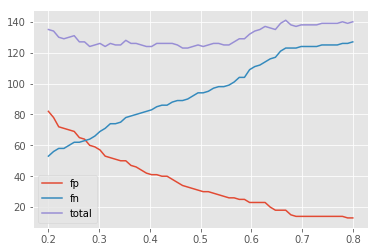

In [51]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.2, 0.8, 60))
df['total'] = df.fp+ df.fn
df.plot()

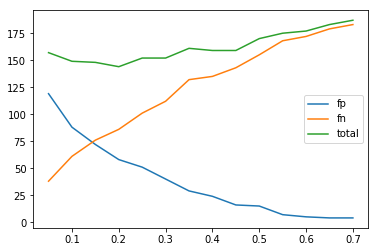

In [7]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.05,0.7, 14))
df['total'] = df.fp+ df.fn
df.plot()  # 14144

,fp,fn,total
0.30,57,107,164
0.35,40,120,160
0.40,33,133,166
0.45,25,139,164
0.50,20,154,174
0.55,17,164,181
0.60,14,174,188
0.65,12,184,196
0.70,10,197,207


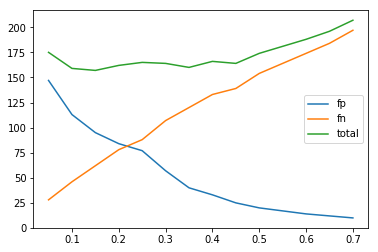

In [11]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.05,0.7, 14))
df['total'] = df.fp+ df.fn
df.plot()  # 1664
df[df.fp <= 70]

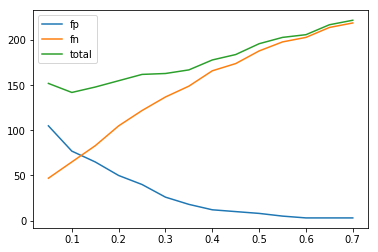

In [8]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.05,0.7, 14))
df['total'] = df.fp+ df.fn
df.plot()  # 1352

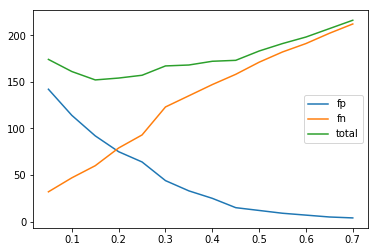

In [8]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.05,0.7, 14))
df['total'] = df.fp+ df.fn
df.plot()  # 1040

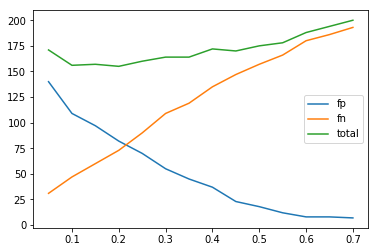

In [8]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.05,0.7, 14))
df['total'] = df.fp+ df.fn
df.plot()

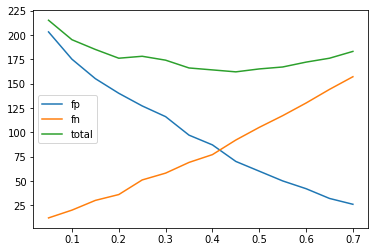

In [8]:
df = pd.DataFrame(data=results, columns=('fp', 'fn'), index=np.linspace(0.05,0.7, 14))
df['total'] = df.fp+ df.fn
df.plot()  # 14872